In [1]:
import yfinance as yf
import pandas as pd
import numpy as np
from arch.univariate import ARCHInMean, GARCH
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_squared_error

In [2]:
start_date = '2019-10-01'
end_date = '2024-10-03'

In [3]:
market = yf.download('^BVSP', start=start_date, end=end_date)['Adj Close'].pct_change().dropna()

[*********************100%***********************]  1 of 1 completed


In [4]:
len(market)

1245

In [5]:
print(market)

Date
2019-10-02   -0.029043
2019-10-03    0.004801
2019-10-04    0.010195
2019-10-07   -0.019288
2019-10-08   -0.005886
                ...   
2024-09-26    0.010822
2024-09-27   -0.002105
2024-09-30   -0.006886
2024-10-01    0.005151
2024-10-02    0.007698
Name: Adj Close, Length: 1245, dtype: float64


In [6]:
cdi_data = pd.read_csv('CDI.csv',sep=';', parse_dates=['Date'],dayfirst=True)
cdi_data.set_index('Date', inplace=True)
cdi_data.index = pd.to_datetime(cdi_data.index, dayfirst=True)

In [7]:
cdi_data['CDI_Return'] = cdi_data['return'].str.replace(',', '.').astype(float)
cdi_data.drop(columns=['return'], inplace=True)

In [8]:
print(cdi_data)

            CDI_Return
Date                  
2019-10-02    0.000209
2019-10-03    0.000209
2019-10-04    0.000209
2019-10-07    0.000209
2019-10-08    0.000209
...                ...
2024-09-26    0.000402
2024-09-27    0.000402
2024-09-30    0.000402
2024-10-01    0.000402
2024-10-02    0.000402

[1257 rows x 1 columns]


In [9]:
cdi_data = cdi_data.loc[market.index]

In [10]:
len(cdi_data)

1245

In [11]:
market_excess=(market-cdi_data['CDI_Return'])

In [12]:
print(market_excess)

Date
2019-10-02   -0.029252
2019-10-03    0.004592
2019-10-04    0.009987
2019-10-07   -0.019497
2019-10-08   -0.006095
                ...   
2024-09-26    0.010420
2024-09-27   -0.002507
2024-09-30   -0.007288
2024-10-01    0.004749
2024-10-02    0.007297
Length: 1245, dtype: float64


In [13]:
tickers=['VALE3.SA', 'PETR4.SA', 'ITUB4.SA', 'PETR3.SA', 'BBDC4.SA', 
'BBAS3.SA', 
'ELET3.SA', 
'B3SA3.SA', 
'WEGE3.SA', 
'SBSP3.SA', 
'ITSA4.SA', 
'ABEV3.SA', 
'BPAC11.SA', 
'EQTL3.SA', 
'RENT3.SA', 
'JBSS3.SA', 
'PRIO3.SA',  
'RADL3.SA', 
'SUZB3.SA', 
'EMBR3.SA', 
'RAIL3.SA', 
'VBBR3.SA', 
'UGPA3.SA', 
'BBSE3.SA', 
'GGBR4.SA', 
'CMIG4.SA', 
'BRFS3.SA', 
'VIVT3.SA', 
'BBDC3.SA', 
'ENEV3.SA', 
'HAPV3.SA', 
'CPLE6.SA', 
'KLBN11.SA', 
'LREN3.SA', 
'TOTS3.SA', 
'CSAN3.SA', 
'ENGI11.SA', 
'TIMS3.SA', 
'CCRO3.SA', 
'ELET6.SA',  
'HYPE3.SA', 
'EGIE3.SA', 
'SANB11.SA', 
'STBP3.SA', 
'TRPL4.SA', 
'CSNA3.SA',
'MULT3.SA', 
'TAEE11.SA', 
'FLRY3.SA', 
'GOAU4.SA', 
'CPFE3.SA', 
'AZZA3.SA', 
'CYRE3.SA',  
'BRAP4.SA', 
'BRKM5.SA', 
'CRFB3.SA',  
'MRFG3.SA', 
'MGLU3.SA', 
'IRBR3.SA', 
'SMTO3.SA',  
'SLCE3.SA', 
'USIM5.SA', 
'YDUQ3.SA', 
'MRVE3.SA', 
'COGN3.SA', 
'BEEF3.SA', 
'AZUL4.SA', 
'EZTC3.SA', 
'ALPA4.SA', 
'PCAR3.SA', 
'CVCB3.SA']


In [14]:
len(tickers)

71

In [15]:
stock_excess=[]

In [16]:
for ticker in tickers:
    stock=yf.download(ticker, start=start_date, end=end_date)['Adj Close'].pct_change().dropna()
    
    data= pd.DataFrame({
        'Ticker': ticker,
        'Stock_Return': stock,
        'CDI_Return': cdi_data['CDI_Return']
    }).dropna()

    data['Stock_Excess'] = (data['Stock_Return'] - data['CDI_Return'])

    stock_excess.append(data)
    

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

In [17]:
stock_excess = pd.concat(stock_excess)
stock_excess= stock_excess[['Ticker', 'Stock_Excess']]

In [18]:
print(stock_excess)

              Ticker  Stock_Excess
Date                              
2019-10-02  VALE3.SA     -0.054914
2019-10-03  VALE3.SA      0.007330
2019-10-04  VALE3.SA      0.025099
2019-10-07  VALE3.SA     -0.012014
2019-10-08  VALE3.SA     -0.015847
...              ...           ...
2024-09-26  CVCB3.SA      0.010468
2024-09-27  CVCB3.SA      0.021104
2024-09-30  CVCB3.SA     -0.021454
2024-10-01  CVCB3.SA     -0.005778
2024-10-02  CVCB3.SA      0.010409

[88395 rows x 2 columns]


In [19]:
fitted_capm_values = []
fitted_garchm_values = []

C:\Users\DELL\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
C:\Users\DELL\anaconda3\Lib\site-packages\arch\univariate\base.py:311: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003303. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
C:\Users\DELL\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
C:\Users\DELL\a

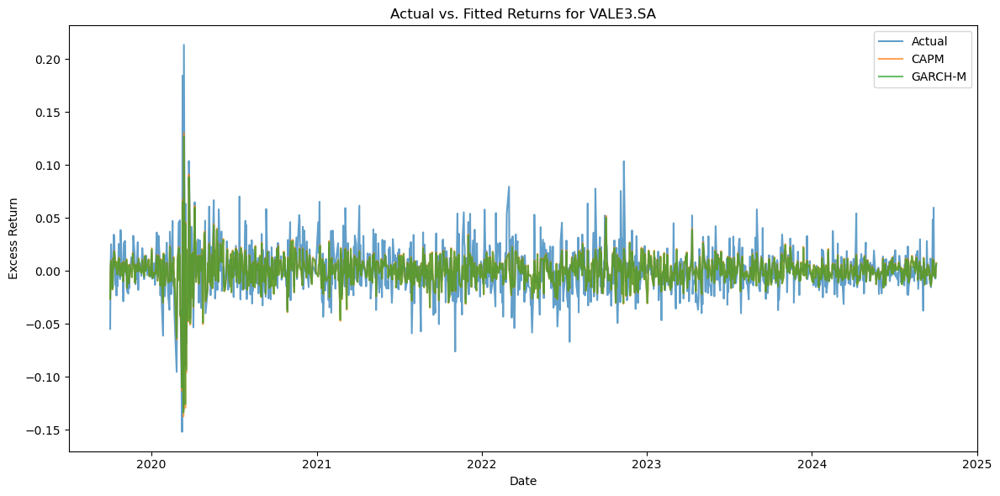

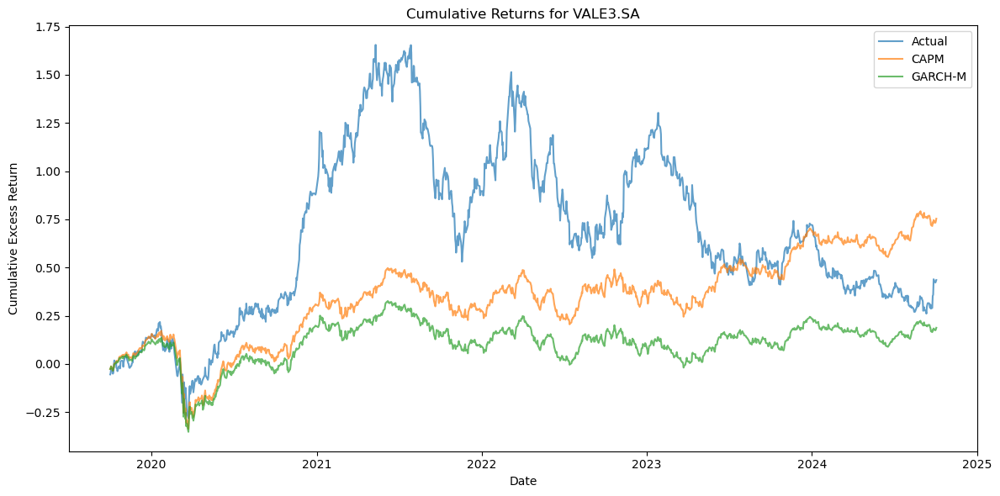

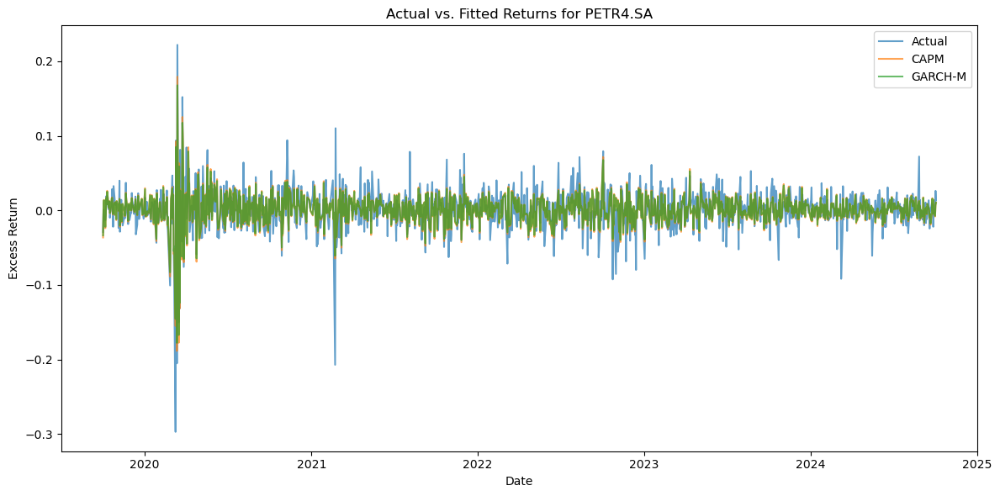

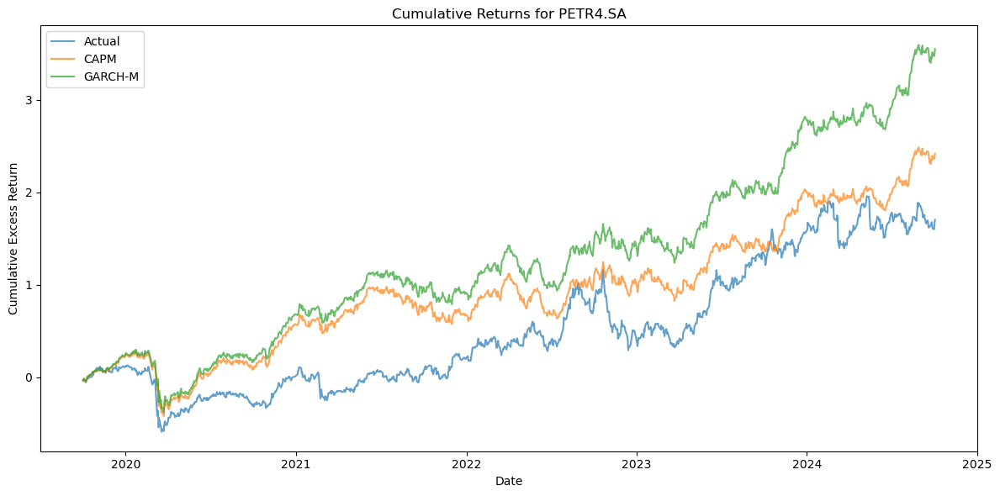

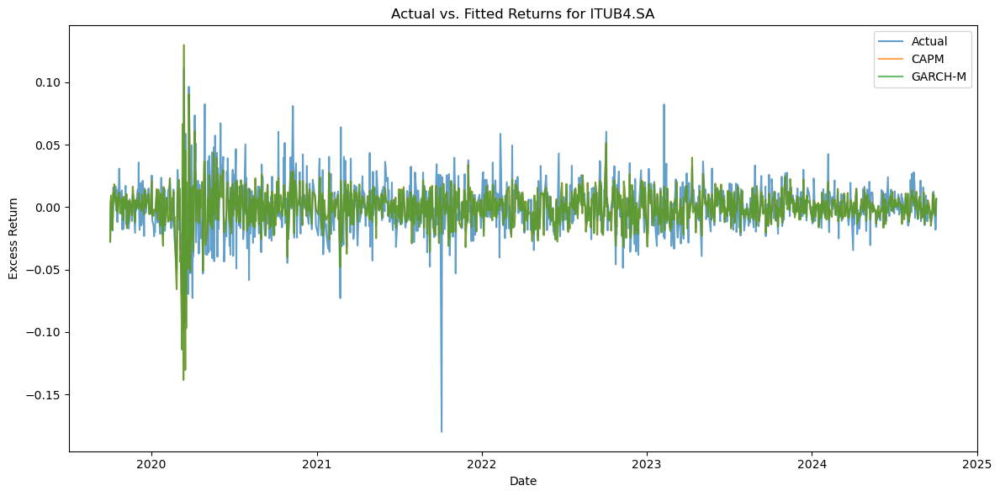

...

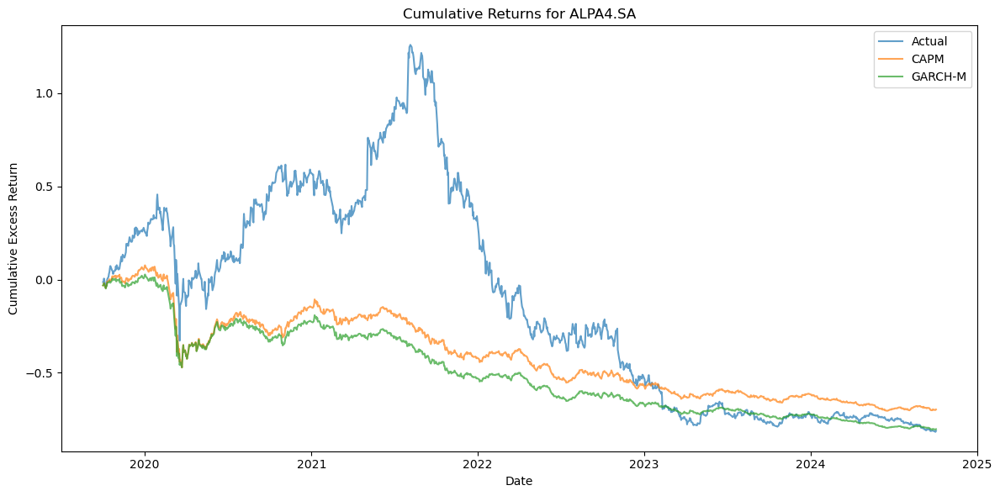

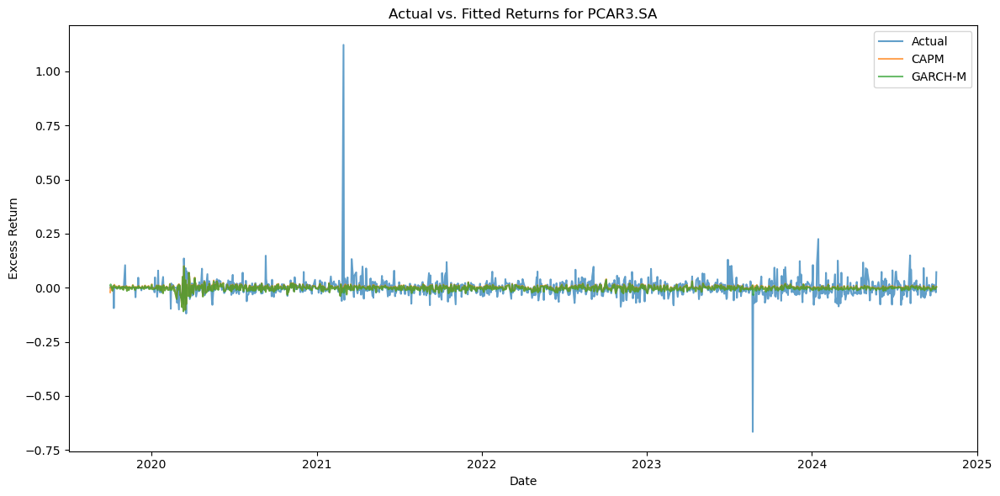

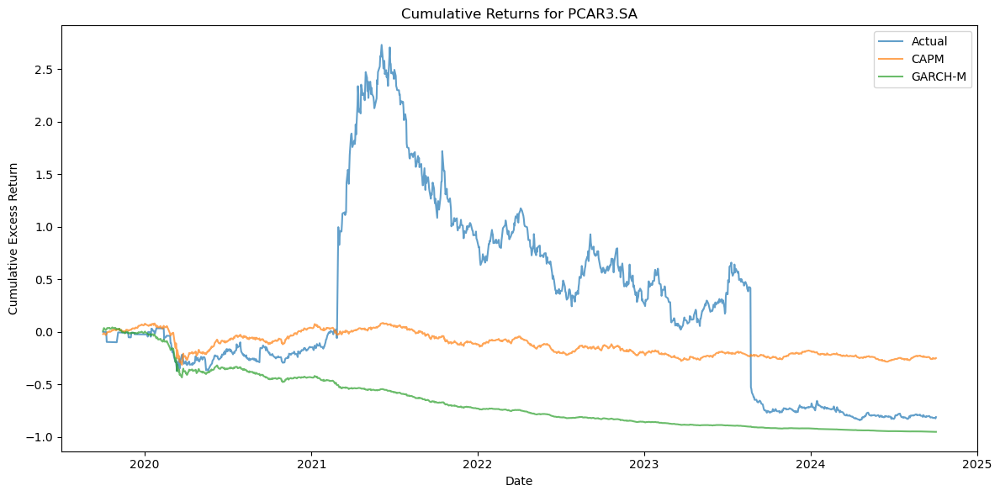

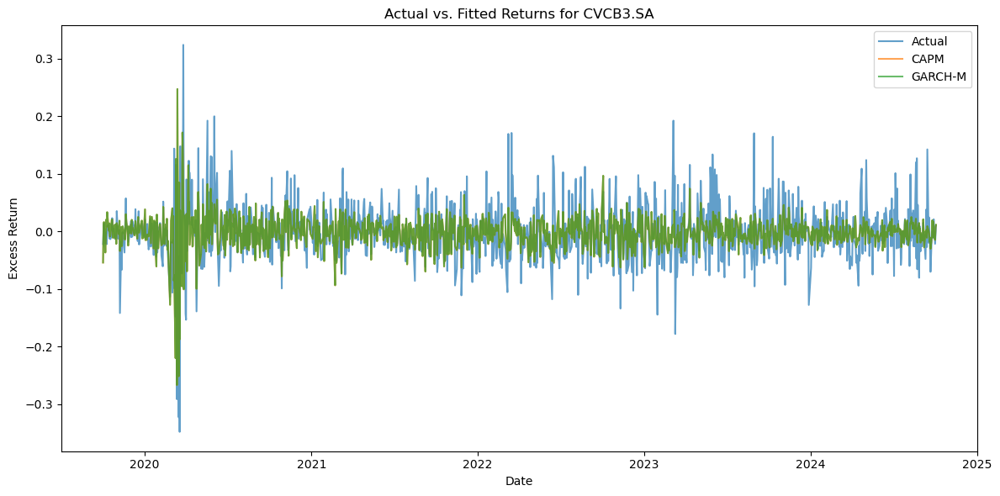

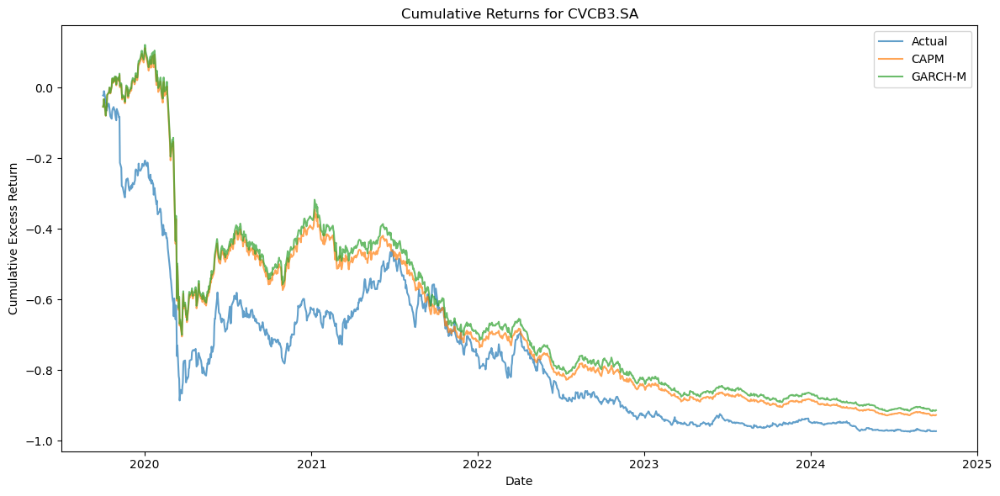

In [20]:
for ticker in stock_excess['Ticker'].unique():
    ticker_data = stock_excess[stock_excess['Ticker'] == ticker]['Stock_Excess']

    
    # Ajusta o modelo CAPM Clássico
    X_capm = sm.add_constant(market_excess.rename('Market_Excess'))
    model_capm = sm.OLS(ticker_data, X_capm).fit()
    fitted_capm = model_capm.predict(X_capm)

    
    #RMSE CAPM
    rmse_capm = mean_squared_error(ticker_data, fitted_capm, squared=False)

    # Juntar resultados do CAPM
    fitted_capm_values.append({
        'Ticker':ticker,
        'Alpha':model_capm.params.get('const', 0),
        'Beta':model_capm.params.get('Market_Excess', 0),
        'RMSE_CAPM':rmse_capm
    })

    #rodar GARCH-M
    model_garchm=ARCHInMean(y=ticker_data, x=market_excess.rename('Market_Excess'), lags=0, constant=True,
                             volatility=GARCH(p=1, o=0, q=1),
                             distribution=None,
                             form='vol')
    
    res_garchm = model_garchm.fit(disp='off')

    # Extrai a volatilidade condicional do modelo GARCH-in-Mean
    conditional_volatility = res_garchm.conditional_volatility

#Cálculo do RMSE do GARCH-M
    fitted_garchm = (
        res_garchm.params.get('Const', 0) +
        res_garchm.params.get('Market_Excess', 0) * market_excess +
        res_garchm.params.get('kappa', 0) * conditional_volatility
    )
    
    rmse_garchm = mean_squared_error(ticker_data, fitted_garchm, squared=False)

    
    # juntar os parâmetros do GARCH-M
    fitted_garchm_values.append({
        'Ticker':ticker,
        'Alpha':res_garchm.params.get('Const', 0),
        'Beta':res_garchm.params.get('Market_Excess', 0),
        'Kappa':res_garchm.params.get('kappa',0),
        'Omega':res_garchm.params.get('omega',0),
        'alpha1':res_garchm.params.get('alpha[1]',0),
        'beta1':res_garchm.params.get('beta[1]',0),
        'RMSE_GARCHM':rmse_garchm
    })
    #Cria um dataframe para os gráficos
    df_plot = pd.DataFrame({
            'Actual': ticker_data,
            'CAPM': fitted_capm,
            'GARCH-M': fitted_garchm
        }).dropna()
    
    # Plota os gráficos comparativos entre CAPM clássico, GARCH-M e resultado verdadeiro
    plt.figure(figsize=(12, 6))
    plt.plot(df_plot.index, df_plot['Actual'], label='Actual', alpha=0.7)
    plt.plot(df_plot.index, df_plot['CAPM'], label='CAPM', alpha=0.7)
    plt.plot(df_plot.index, df_plot['GARCH-M'], label='GARCH-M', alpha=0.7)
    plt.title(f'Actual vs. Fitted Returns for {ticker}')
    plt.xlabel('Date')
    plt.ylabel('Excess Return')
    plt.legend()
    plt.tight_layout()
    plt.show

    # Optional: Plot cumulative returns
    df_cum_returns = (1 + df_plot).cumprod() - 1
    plt.figure(figsize=(12, 6))
    plt.plot(df_cum_returns.index, df_cum_returns['Actual'], label='Actual', alpha=0.7)
    plt.plot(df_cum_returns.index, df_cum_returns['CAPM'], label='CAPM', alpha=0.7)
    plt.plot(df_cum_returns.index, df_cum_returns['GARCH-M'], label='GARCH-M', alpha=0.7)
    plt.title(f'Cumulative Returns for {ticker}')
    plt.xlabel('Date')
    plt.ylabel('Cumulative Excess Return')
    plt.legend()
    plt.tight_layout()
    plt.show
    

In [21]:
capm_results_df = pd.DataFrame(fitted_capm_values)
capm_results_df.to_excel('capm_results.xlsx', index=False)
garchm_results_df = pd.DataFrame(fitted_garchm_values)
garchm_results_df.to_excel('garchm_results.xlsx', index=False)

In [22]:
#for ticker in stock_excess['Ticker'].unique():
    #ticker_data = stock_excess[stock_excess['Ticker'] == ticker]['Stock_Excess']



    #model_garchm=ARCHInMean(y=ticker_data, x=market_excess.rename('Market_Excess'), lags=0, constant=True,
    #                         volatility=GARCH(p=1, o=0, q=1),
     #                        distribution=None,
      #                       form='vol')

    #res_garchm = model_garchm.fit(disp='off')
    
    # Extrai a volatilidade condicional do modelo GARCH-in-Mean
    #conditional_volatility = res_garchm.conditional_volatility

    #Cálculo do MSE
    #fitted_garchm = (
     #   res_garchm.params.get('Const', 0) +
      #  res_garchm.params.get('Market_Excess', 0) * market_excess +
       # res_garchm.params.get('kappa', 0) * conditional_volatility
    #)
    
    #mse_garchm = mean_squared_error(ticker_data, fitted_garchm)

    
    # Extrai os parâmetros estimados do modelo GARCH-in-Mean
    #fitted_garchm_values.append({
     #   'Ticker':ticker,
      #  'Alpha':res_garchm.params.get('Const', 0),
       # 'Beta':res_garchm.params.get('Market_Excess', 0),
        #'Kappa':res_garchm.params.get('kappa',0),
        #'Omega':res_garchm.params.get('omega',0),
        #'alpha1':res_garchm.params.get('alpha[1]',0),
        #'beta1':res_garchm.params.get('beta[1]',0),
        #'MSE_GARCHM':mse_garchm
    #})
    
    




In [23]:
#garchm_results_df = pd.DataFrame(fitted_garchm_values)
#garchm_results_df.to_excel('garchm_results.xlsx', index=False)